In [19]:
include("Harvey_in_Nelson_funcs.jl")
using .julia


In [20]:
using LinearAlgebra
using Random
using Distributions
using ProgressMeter
using Statistics  
using SpecialFunctions
using NLopt

using Plots
using StatsPlots  
using DataFrames
using XLSX


## Estimate

In [21]:
# Specify the file path and sheet name
file_path = "quarterly_gdp.xlsx"
sheet_name = "Quarterly GDP"

# Open the Excel file and load the data from the specified sheet into a DataFrame
data = XLSX.readtable(file_path, sheet_name) |> DataFrame

# Display data
println(data)

# Get the number of observations
num_obs = size(data, 1)
println("Number of observations: ", num_obs)




134×2 DataFrame
 Row │ Date    Value 
     │ Any     Any   
─────┼───────────────
   1 │ 1991K1  364.6
   2 │ 1991K2  364.7
   3 │ 1991K3  368.6
   4 │ 1991K4  364.5
   5 │ 1992K1  371.5
   6 │ 1992K2  367.9
   7 │ 1992K3  377.2
   8 │ 1992K4  375.4
   9 │ 1993K1  371.8
  10 │ 1993K2  370
  11 │ 1993K3  373.2
  12 │ 1993K4  375.7
  13 │ 1994K1  385.1
  14 │ 1994K2  391.5
  15 │ 1994K3  393.3
  16 │ 1994K4  399.8
  17 │ 1995K1  404.2
  18 │ 1995K2  402.5
  19 │ 1995K3  404
  20 │ 1995K4  406.7
  21 │ 1996K1  407.8
  22 │ 1996K2  418.3
  23 │ 1996K3  419
  24 │ 1996K4  419.1
  25 │ 1997K1  424.8
  26 │ 1997K2  431.6
  27 │ 1997K3  429.7
  28 │ 1997K4  430.9
  29 │ 1998K1  437.5
  30 │ 1998K2  434
  31 │ 1998K3  441.2
  32 │ 1998K4  444.1
  33 │ 1999K1  447.8
  34 │ 1999K2  449.8
  35 │ 1999K3  451.7
  36 │ 1999K4  459.7
  37 │ 2000K1  462.9
  38 │ 2000K2  468.1
  39 │ 2000K3  468.9
  40 │ 2000K4  476.5
  41 │ 2001K1  469.1
  42 │ 2001K2  472.2
  43 │ 2001K3  475.3
  44 │ 2001K4  477.7
  

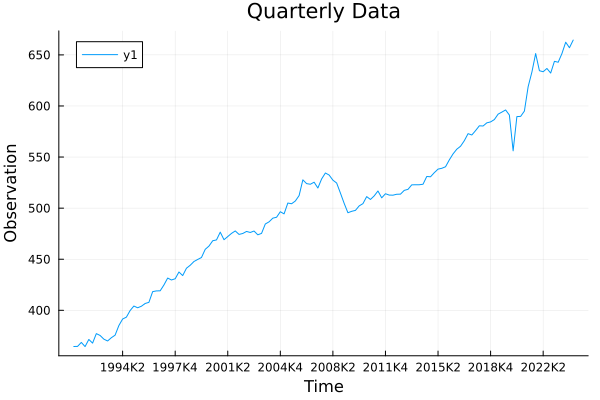

In [22]:
y = data[:, 2]
# y = log.(y)
dates = data[:, 1]

# Plot the data
plot(dates,y, title="Quarterly Data", xlabel="Time", ylabel="Observation")

In [23]:
#Define model
n_order = 2
state_dim = 2+2*n_order
alpha_init = zeros(state_dim)
alpha_init[1] = y[1]
P1 = Matrix{Float64}(I(state_dim))*100  # Initial covariance matrix

#Priors

a_rho = 0.01
b_rho = 0.97

a_lambda = 0.01
b_lambda = π

a_xi = 1e-6
b_xi = 1e-6

a_kappa_0 = 1e-6
b_kappa_0 = 1e-6

a_kappa_1 = 1e-6
b_kappa_1 = 1e-6

a_epsilon = 1e-6
b_epsilon = 1e-6

a_omega = -100
b_omega = 0

a_p = 0.01
b_p = 0.99

a_q = 0.01
b_q = 0.99


priors = [a_rho, b_rho, a_lambda, b_lambda, a_xi, b_xi, a_kappa_0, b_kappa_0, a_kappa_1, b_kappa_1, a_epsilon, b_epsilon, a_omega, b_omega, a_p, b_p, a_q, b_q]




18-element Vector{Float64}:
    0.01
    0.97
    0.01
    3.141592653589793
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
 -100.0
    0.0
    0.01
    0.99
    0.01
    0.99

In [24]:
# Run MCMC initialization
chain_init_burned, Sigma, acceptance_rate_init, chain_init, theta_samples_init = initialize_mcmc(
    y,
    priors,
    alpha_init, 
    P1, 
    n_order; 
    n_init=80000, 
    burn_init=40000, 
    omega_init=0.08)

Initialization Phase 100%|███████████████████████████████| Time: 0:05:31


Initialization Acceptance Rate: 33.55625 %


([0.35179068944071895 -2.7511701556541173 … -0.9352445173098092 3.6653345976639304; 0.5156666125052667 -2.4004253205852155 … -0.96246701593914 3.4282838759178054; … ; 0.5440773016907905 -2.570946102060306 … 0.21811670518236362 3.1664894796273346; 0.5440773016907905 -2.570946102060306 … 0.21811670518236362 3.1664894796273346], [1.1691853683516713 -0.2300369241868297 … -0.12633016007708686 0.035964724016235385; -0.2300369241868297 1.7314819788498594 … -0.09995238025094859 0.07672353069834642; … ; -0.12633016007708686 -0.09995238025094859 … 0.8017414364193722 0.10621229293715337; 0.035964724016235385 0.07672353069834642 … 0.10621229293715337 0.8353795365496661], 0.3355625, [0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.5440773016907905 -2.570946102060306 … 0.21811670518236362 3.1664894796273346; 0.5440773016907905 -2.570946102060306 … 0.21811670518236362 3.1664894796273346], [0.5735696790245961 0.19796006434315436 … 0.2862246894541534 0.965542315732413; 0.6110885616261305 0.2703614569407572

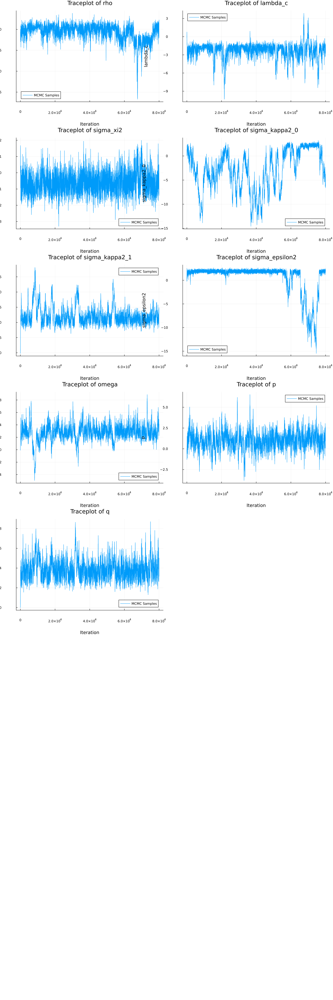

In [25]:
parameters = ["rho", "lambda_c", "sigma_xi2", "sigma_kappa2_0", "sigma_kappa2_1",
              "sigma_epsilon2", "omega", "p", "q"]

n_params = length(parameters)

# Initialize a list to hold the plots
p_list = []

for i in 1:n_params
    param_samples_init = chain_init[:, i]
    
    # Traceplot of MCMC samples
    p2 = plot(param_samples_init, label="MCMC Samples", xlabel="Iteration", ylabel=parameters[i],
              title="Traceplot of $(parameters[i])")

    
    # Add plots to the list
    push!(p_list, p2)
end

# Display the plots
nrows = n_params
ncols = 2
plot(p_list..., layout=(nrows, ncols), size=(1200, 400 * n_params))


In [35]:
# Run MCMC recursion
theta_samples_burned, alpha_samples, acceptance_rate_rec, p_res = recursion_mcmc(
    y, 
    priors,
    alpha_init, 
    P1, 
    n_order, 
    chain_init_burned,
    Sigma; 
    n_rec =40000, 
    burn_rec=20000, 
    omega_rec=0.05)


Recursion Phase 100%|████████████████████████████████████| Time: 0:04:26


Recursion Acceptance Rate: 17.235 %


([0.5114361901502079 0.16277884834860457 … 0.9050340175504229 0.9794151522357356; 0.5114361901502079 0.16277884834860457 … 0.9050340175504229 0.9794151522357356; … ; 0.3347930231392204 0.44093723888491065 … 0.8363276829770842 0.9857146372414902; 0.4384193714653397 0.46962458890410874 … 0.8127732685361195 0.9846921029668831], Any[[364.59999999999997 0.0 … 0.0 0.0; 364.8837381893364 0.17009192633386935 … -0.19824501125013808 -0.3144827912367249; … ; 664.7742204917818 3.742771526081409 … -5.694006650289725 -3.719695611582167; 667.2999250439804 3.652243136992058 … -3.0754482822010503 -1.1962249824924462], [364.59999999999997 0.0 … 0.0 0.0; 364.8837381893364 0.17009192633386935 … -0.19824501125013808 -0.3144827912367249; … ; 664.7742204917818 3.742771526081409 … -5.694006650289725 -3.719695611582167; 667.2999250439804 3.652243136992058 … -3.0754482822010503 -1.1962249824924462], [364.59999999999997 0.0 … 0.0 0.0; 364.8837381893364 0.17009192633386935 … -0.19824501125013808 -0.31448279123672

In [36]:


# Number of optimization runs
num_runs = 1

upper_bounds = [1.0, π, Inf, Inf, Inf, Inf, Inf, 1.0, 1.0]
lower_bounds = [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -Inf, 0.0, 0.0]

              
# Function to generate initial parameters from specified priors
function draw_initial_params(parameters)
    initial_params = Float64[]  # Enforce Float64 type for the parameters
    for param in parameters
        if param == "rho"
            push!(initial_params, rand(Uniform(a_rho, b_rho)))
        elseif param == "lambda_c"
            push!(initial_params, rand(Uniform(a_lambda, b_lambda)))
        elseif param in ["p", "q"]
            # Uniform prior between 0 and 1
            push!(initial_params, rand(Uniform(a_p, b_p)))
        elseif param == "omega"
            # Normal prior
            push!(initial_params, rand(Normal(-10, 1)))
        else
            # Inverse-Gamma prior
            push!(initial_params, rand(InverseGamma(3, 1)))
        end
    end
    return initial_params
end

# Define the objective function
function obj(params::Vector, grad::Vector)
    try
        return neg_log_likelihood(params, y, alpha_init, P1, n_order)
    catch e
        return 1e10  # Return a large number in case of error
    end
end

# Run optimization with multiple initial guesses

best_minf = Inf
best_params = nothing

pb = Progress(num_runs; desc="MLE Optimization")
for run in 1:num_runs
    
    # Draw a new set of initial parameters from priors
    initial_params = draw_initial_params(parameters)

    # Create the optimizer
    opt = Opt(:LN_NELDERMEAD, length(initial_params))
    opt.lower_bounds = lower_bounds
    opt.upper_bounds = upper_bounds
    opt.min_objective = obj
    opt.maxeval = 100000
    opt.xtol_rel = 1e-6

    # Run the optimization
    (minf, estimated_params, ret) = NLopt.optimize(opt, initial_params)
 
    # Save the best result
    if minf < best_minf
        best_minf = minf
        best_params = estimated_params
    end

    next!(pb)
end


# Display the best estimated parameters
println("Best Estimated Parameters: ", best_params)


Best Estimated Parameters: [0.3319324819968563, 0.0, 4.769694140917066, 18.886400159833443, 13.26525752972982, 6.1332628106748555, -179.06995632214125, 0.9999999924768375, 1.0]


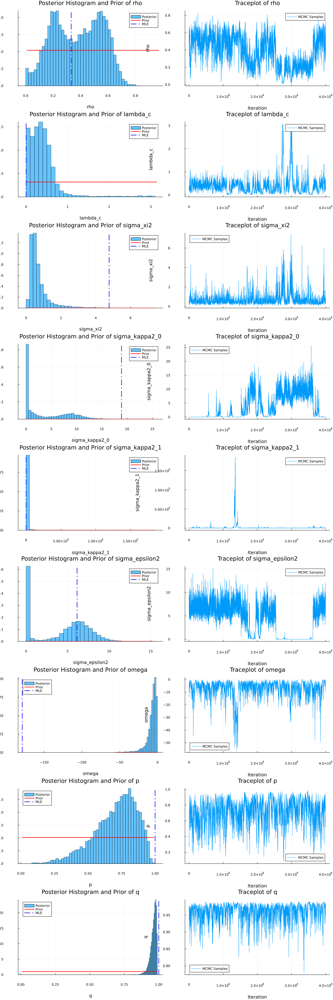

In [45]:
# Initialize a list to hold the plots
p_list = []

for i in 1:n_params
    # param_samples = theta_samples_burned[:, i]
    param_samples = theta_samples_init[:,i]

    
    # Histogram of posterior samples
    p1 = histogram(param_samples, bins=50, normalize=true, alpha=0.6,
                   label="Posterior", xlabel=parameters[i], ylabel="Density",
                   title="Posterior Histogram and Prior of $(parameters[i])")
    
    # Define the prior distribution
    if parameters[i] == "rho"
        # Uniform prior between 0 and 0.999
        a = a_rho
        b = b_rho
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] == "lambda_c"
        # Uniform prior between 0 and π
        a = a_lambda
        b = b_lambda
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] in ["p", "q"]
        # Uniform prior between 0 and 1
        a = a_p
        b = 1b_p
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] == "omega"
        a = a_omega
        b = b_omega
        x_values = range(minimum(param_samples), maximum(param_samples), length=200)
        prior_pdf = pdf.(Normal(a, b), x_values)
    elseif parameters[i] == "sigma_xi2"
        a = a_xi
        b = b_xi
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_kappa2_0"
        a = a_kappa_0
        b = b_kappa_0
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_kappa2_1"
        a = a_kappa_1
        b = b_kappa_1
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_epsilon2"
        a = a_epsilon
        b = b_epsilon
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    end
    
    # Overlay prior PDF on histogram
    plot!(p1, x_values, prior_pdf, label="Prior", color=:red, linewidth=2)

    #MLE estimates
    vline!(p1, [best_params[i]], label="MLE", color=:blue, linestyle=:dashdot, linewidth=2)
    
    # Traceplot of MCMC samples
    p2 = plot(param_samples, label="MCMC Samples", xlabel="Iteration", ylabel=parameters[i],
              title="Traceplot of $(parameters[i])")
    
 
    
    # Add plots to the list
    push!(p_list, p1)
    push!(p_list, p2)
end

# Display the plots in a grid layout
nrows = n_params
ncols = 2
plot(p_list..., layout=(nrows, ncols), size=(1200, 400 * n_params))


In [38]:
# Calculate means of posterior samples
chain_rec_burned_means = mean(theta_samples_burned, dims=1)  # 1 x n_params array
chain_rec_burned_means = vec(chain_rec_burned_means)  # Convert to a vector


9-element Vector{Float64}:
    0.39419294578268116
    0.3704969350970885
    0.7415248517184515
    2.3711766407665715
 1468.800498412531
    5.085003531533327
   -5.955820324108529
    0.7388075739732036
    0.9597102470093425

In [39]:

# Create the DataFrame
data = DataFrame(Dict(
    "Parameter" => parameters,
    "MCMC Estimate" => chain_rec_burned_means,
    "MLE Estimate" => best_params,  # Include if available
))

# Display the DataFrame
display(data)


Row,MCMC Estimate,MLE Estimate,Parameter
,Float64,Float64,String
1,0.394193,0.331932,rho
2,0.370497,0.0,lambda_c
3,0.741525,4.76969,sigma_xi2
4,2.37118,18.8864,sigma_kappa2_0
5,1468.8,13.2653,sigma_kappa2_1
6,5.085,6.13326,sigma_epsilon2
7,-5.95582,-179.07,omega
8,0.738808,1.0,p
9,0.95971,1.0,q


134
134


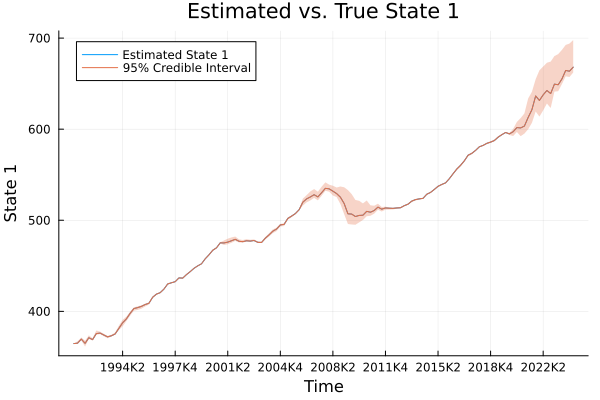

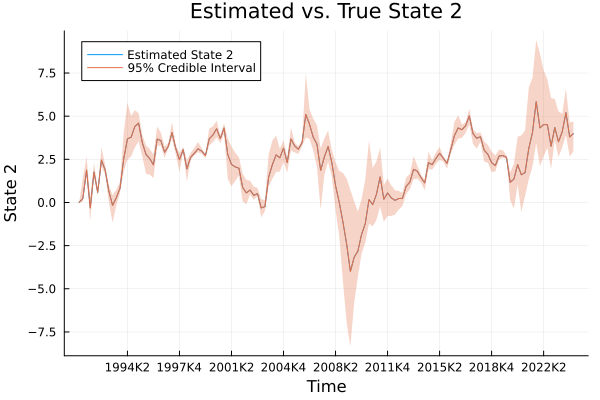

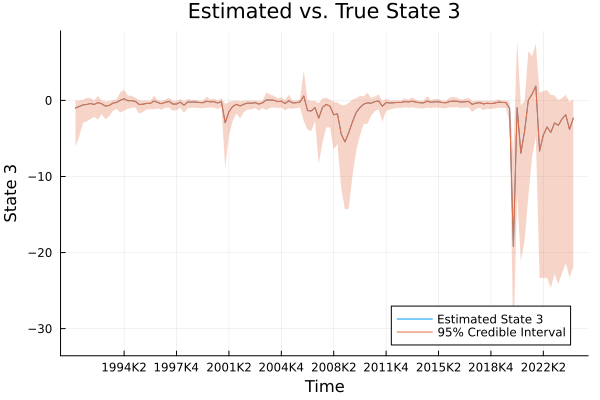

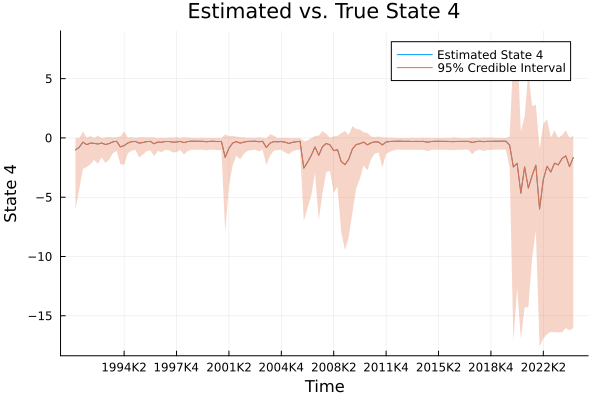

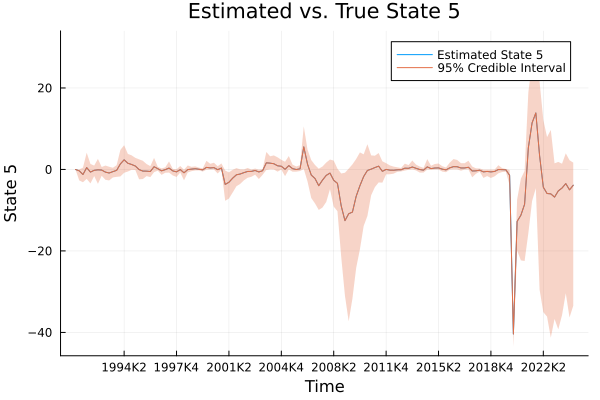

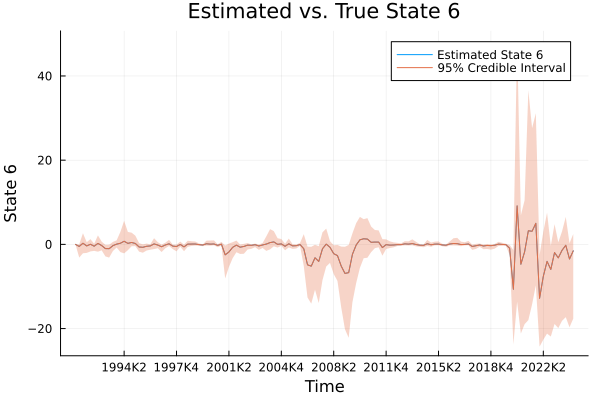

In [40]:
# Collect alpha samples into a 3D array
n_samples = length(alpha_samples)
n_time_steps = size(alpha_samples[1], 1)
state_dim = size(alpha_samples[1], 2)

dates_plot = dates

println(n_time_steps)
println(length(dates_plot))

# Initialize array to hold alpha samples
alpha_samples_array = Array{Float64}(undef, n_samples, n_time_steps, state_dim)

for i in 1:n_samples
    alpha_samples_array[i, :, :] = alpha_samples[i]
end


# Compute posterior mean over samples (dimension 1)
alpha_mean = mean(alpha_samples_array, dims=1)  # 1 x n_time_steps x state_dim
alpha_mean = dropdims(alpha_mean; dims=1)  # n_time_steps x state_dim

# Compute credible intervals
alpha_lower = mapslices(x -> quantile(x, 0.025), alpha_samples_array; dims=1)
alpha_lower = dropdims(alpha_lower; dims=1)
alpha_upper = mapslices(x -> quantile(x, 0.975), alpha_samples_array; dims=1)
alpha_upper = dropdims(alpha_upper; dims=1)



time = 1:n_time_steps

for s in 1:state_dim
    p = plot(dates_plot, alpha_mean[:, s], label="Estimated State $(s)", xlabel="Time",
             ylabel="State $(s)", title="Estimated vs. True State $(s)")
    
    # Add credible intervals using the `ribbon` argument
    plot!(dates_plot, alpha_mean[:, s], ribbon=(alpha_mean[:, s] .- alpha_lower[:, s],
          alpha_upper[:, s] .- alpha_mean[:, s]), fillalpha=0.3, label="95% Credible Interval")
    
    # # Plot true state (assuming you have `alpha_true` from data simulation)
    # plot!(time, alpha[1:n_time_steps, s], label="True State $(s)", linestyle=:dash, color=:red)
    
    display(p)
end


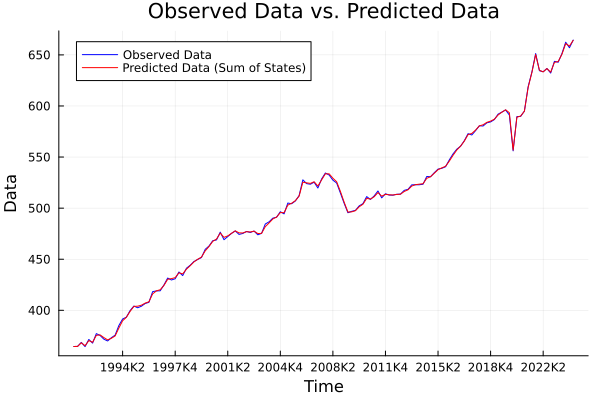

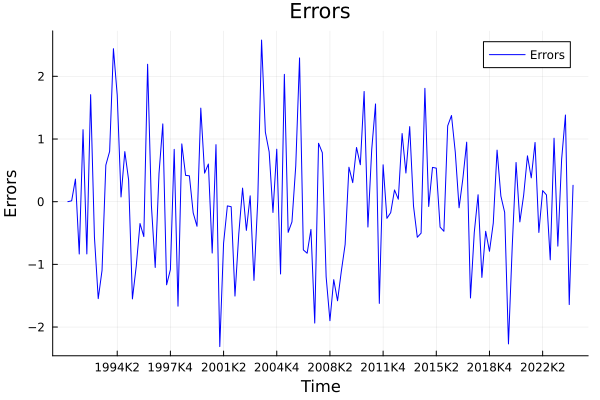

In [41]:
# Compute y_pred
state_indices = [1, 2+2*n_order-1]  # Adjust as necessary

y_pred = alpha_mean[:, state_indices[1]] .+ alpha_mean[:, state_indices[2]]

time = 1:length(y_pred)
y_adjusted = y

p = plot(dates_plot, y_adjusted, label="Observed Data", color=:blue)
plot!(p, dates_plot, y_pred, label="Predicted Data (Sum of States)", color=:red)
xlabel!("Time")
ylabel!("Data")
title!("Observed Data vs. Predicted Data")
display(p)


errors = y_adjusted .- y_pred

p_error = plot(dates_plot, errors, label="Errors", color=:blue)
xlabel!("Time")
ylabel!("Errors")
title!("Errors")
display(p_error)


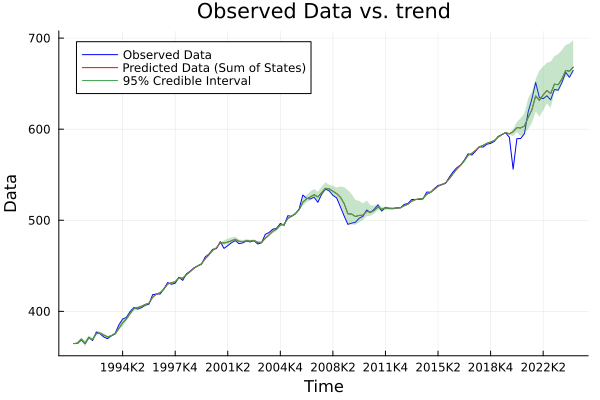

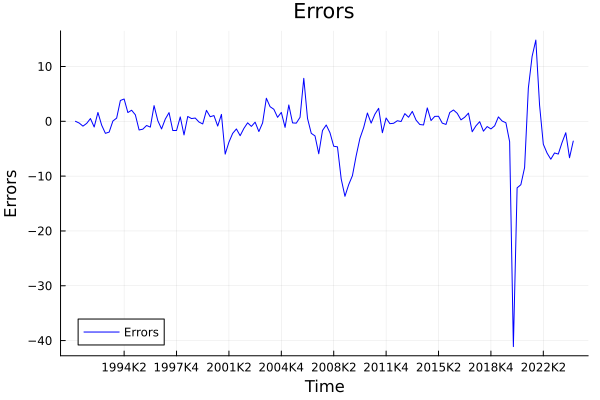

In [42]:
# estimated state 1 and true observation y
# Compute y_pred
state_indices = [1, 2+2*n_order-1]  # Adjust as necessary

y_pred = alpha_mean[:, state_indices[1]] 

time = 1:length(y_pred)
y_adjusted = y[1:length(y_pred)]  # Adjust if lengths differ

p = plot(dates_plot, y_adjusted, label="Observed Data", color=:blue)
plot!(p, dates_plot, y_pred, label="Predicted Data (Sum of States)", color=:red)
xlabel!("Time")
ylabel!("Data")
title!("Observed Data vs. trend")

# Add credible intervals using the `ribbon` argument
plot!(dates_plot, y_pred, ribbon=(alpha_mean[:, state_indices[1]] .- alpha_lower[:, state_indices[1]],
      alpha_upper[:, state_indices[1]] .- alpha_mean[:, state_indices[1]]), fillalpha=0.3, label="95% Credible Interval")
display(p)


errors = y_adjusted .- y_pred

p_error = plot(dates_plot, errors, label="Errors", color=:blue)
xlabel!("Time")
ylabel!("Errors")
title!("Errors")
display(p_error)





### Probability of recesion

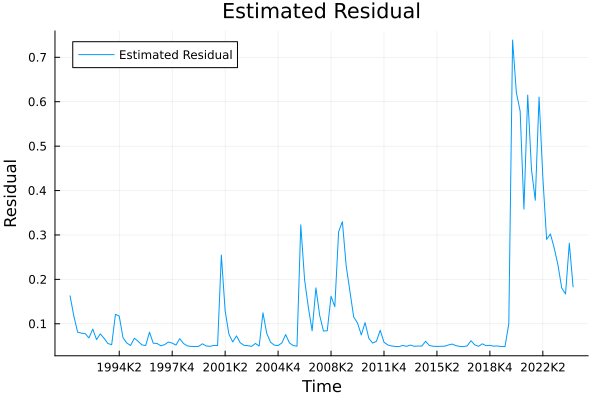

LoadError: LoadError: UndefVarError: `@save` not defined
in expression starting at In[43]:22

In [43]:
# Initialize array to hold p_res samples
n_p_res = length(p_res)
n_time_steps = size(p_res[1], 1)
dim_res = size(p_res[1], 2)
p_res_array = Array{Float64}(undef, n_p_res, n_time_steps, dim_res)

for i in 1:n_samples
    p_res_array[i, :, :] = p_res[i]
end

p_res_array_mean = mean(p_res_array, dims=1)  # 1 x n_time_steps x dim_res


p_res_mean = p_res_array_mean[1,:,2]

p = plot(dates_plot, p_res_mean, label="Estimated Residual", xlabel="Time",
             ylabel="Residual", title="Estimated Residual")

display(p)

#save p_res_mean to a file
@save "p_res_mean_kim_nelson.jld2" p_res_mean


## Graphs from MLE estimates


In [ ]:
logL, a_mle, p_res_mle = switching_kalman_filter(y, best_params, n_order, alpha_init, P1)

(-419.597763780447, [364.59999999999997 0.0 … 0.0 0.0; 364.8654972401826 0.11909472957309872 … -0.1706387633778842 -0.2808783314981752; … ; 660.3642092971461 3.461789552508565 … -0.679521835613078 0.4397253209873385; 664.0084273914006 3.567108043571276 … 0.4266415308806738 -0.0716502821613694], [0.9616441485858875 0.038355851414112505; 0.9833895740648955 0.016610425935104638; … ; 0.9888270476681466 0.011172952331853437; 0.9888286103981982 0.01117138960180167])

In [ ]:
# Collect alpha samples into a 3D array
n_time_steps = size(alpha_samples[1])
state_dim = size(alpha_samples[2])

dates_plot = dates

# p = plot(dates_plot, a_mle[:,1], lastimated State ", xlabel="Time",
#              ylabel="State ", title="Estimabel="Eted vs. True State ")

for s in 1:state_dim
        p = plot(dates_plot, a_mle[:, s], label="Estimated State MLE $(s)", xlabel="Time",
            ylabel="State $(s)", title="Estimated vs. True State $(s)")
        
        display(p)
end
    



LoadError: MethodError: no method matching (::Colon)(::Int64, ::Tuple{Int64, Int64})

[0mClosest candidates are:
[0m  (::Colon)(::T, ::Any, [91m::T[39m) where T<:Real
[0m[90m   @[39m [90mBase[39m [90m[4mrange.jl:50[24m[39m
[0m  (::Colon)(::A, ::Any, [91m::C[39m) where {A<:Real, C<:Real}
[0m[90m   @[39m [90mBase[39m [90m[4mrange.jl:10[24m[39m
[0m  (::Colon)(::T, ::Any, [91m::T[39m) where T
[0m[90m   @[39m [90mBase[39m [90m[4mrange.jl:49[24m[39m
[0m  ...
